In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
warnings.filterwarnings('ignore')

In [3]:
BASE_DIR = '/kaggle/input/anime-faces/data'

In [4]:
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [5]:
image_paths[:5]

['/kaggle/input/anime-faces/data/21130.png',
 '/kaggle/input/anime-faces/data/9273.png',
 '/kaggle/input/anime-faces/data/18966.png',
 '/kaggle/input/anime-faces/data/14127.png',
 '/kaggle/input/anime-faces/data/18054.png']

In [6]:
len(image_paths)

21552

In [7]:
image_paths.remove('/kaggle/input/anime-faces/data/data')

In [8]:
len(image_paths)

21551

In [ ]:
plt.figure(figsize=(20,20))
temp_images=image_paths[:49]
index = 1
for image_path in temp_images:
    plt.subplot(7,7,index)
    img=load_img(image_path)
    img= np.array(img)
    plt.imshow(img)
    plt.axis('off')
    index+=1
    
    

In [10]:
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images= np.array(train_images)
    

In [11]:
train_images[0].shape

(64, 64, 3)

In [12]:
train_images = train_images.reshape(train_images.shape[0], 64,64,3).astype('float32')

In [13]:
train_images = (train_images - 127.5)/127.5

In [14]:
train_images[0]

array([[[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.70980394, -0.88235295, -0.6862745 ],
        [-0.7019608 , -1.        , -0.7176471 ],
        ...,
        [-0.09019608,  0.01176471,  0.3882353 ],
        [-0.19215687,  0.05882353,  0.4509804 ],
        [-0.34117648, -0.13725491,  0.29411766]],

       [[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.73333335, -0.8666667 , -0.7019608 ],
        [-0.52156866, -0.8666667 , -0.5686275 ],
        ...,
        [-0.29411766,  0.01176471,  0.3019608 ],
        [-0.08235294,  0.15294118,  0.5294118 ],
        [-0.23921569,  0.09019608,  0.45882353]],

       [[-0.7019608 , -0.8901961 , -0.7019608 ],
        [-0.7176471 , -0.8745098 , -0.69411767],
        [-0.5686275 , -0.8509804 , -0.58431375],
        ...,
        [-0.22352941,  0.1764706 ,  0.48235294],
        [-0.13725491,  0.1764706 ,  0.4745098 ],
        [-0.06666667,  0.24705882,  0.5058824 ]],

       ...,

       [[-0.30980393, -0.6862745 , -0.29411766],
        [-0

In [15]:
LATENT_DIM = 100
WEIGHT_INIT = keras.initializers.RandomNormal(mean = 0.0, stddev = 0.02)
CHANNELS=3


In [16]:
model = Sequential(name='generator')
model.add(layers.Dense(8*8*512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Reshape((8,8,512)))

model.add(layers.Conv2DTranspose(256, (4,4), strides=(2,2), padding='same',kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same',kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same',kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS,(4,4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

In [17]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self,num_imgs=25,latent_dim=100):
        self.num_imgs=num_imgs
        self.latent_dim=latent_dim
        self.noise = tf.random.normal([25,latent_dim])

    def on_epoch_end(self,epoch,logs=None):
        g_img = self.model.generator(self.noise)
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8,8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        plt.show()

    def on_train_end(self,logs=None):
        self.model.generator.save('generator.h5') 

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR,beta_1=0.5), loss_fn = BinaryCrossentropy())

Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - d_loss: 1.3422 - g_loss: 1.7440

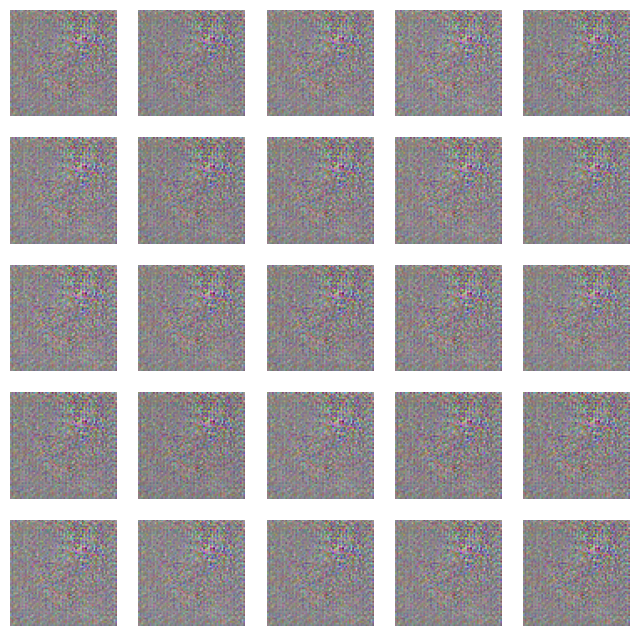

674/674 ━━━━━━━━━━━━━━━━━━━━ 48s 51ms/step - d_loss: 1.3412 - g_loss: 1.7454
Epoch 2/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.2319 - g_loss: 3.1366

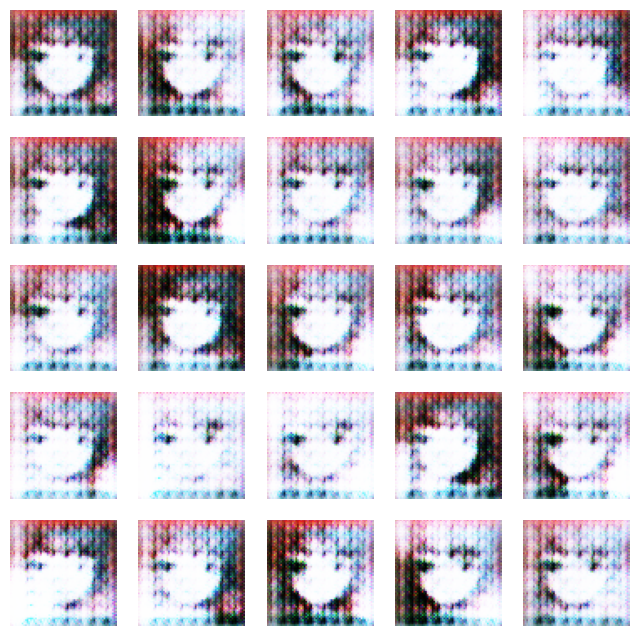

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.2322 - g_loss: 3.1355
Epoch 3/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.5830 - g_loss: 1.7737

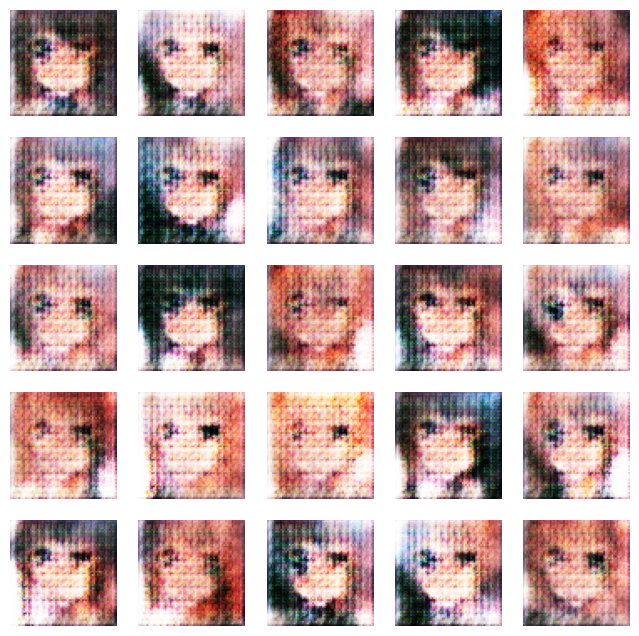

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.5830 - g_loss: 1.7733
Epoch 4/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.5963 - g_loss: 1.6385

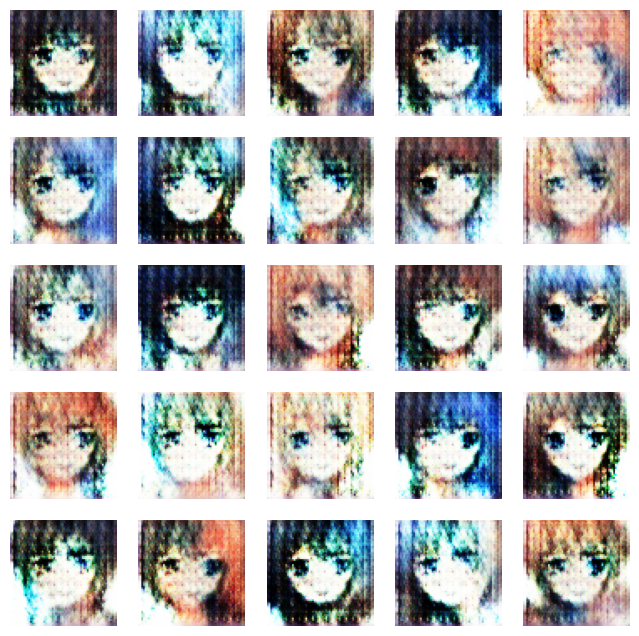

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.5964 - g_loss: 1.6385
Epoch 5/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6404 - g_loss: 1.5718

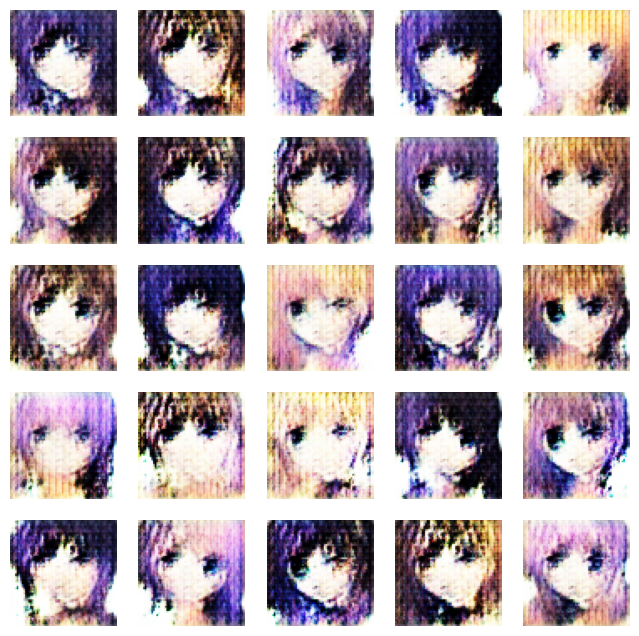

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6404 - g_loss: 1.5718
Epoch 6/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6366 - g_loss: 1.5572

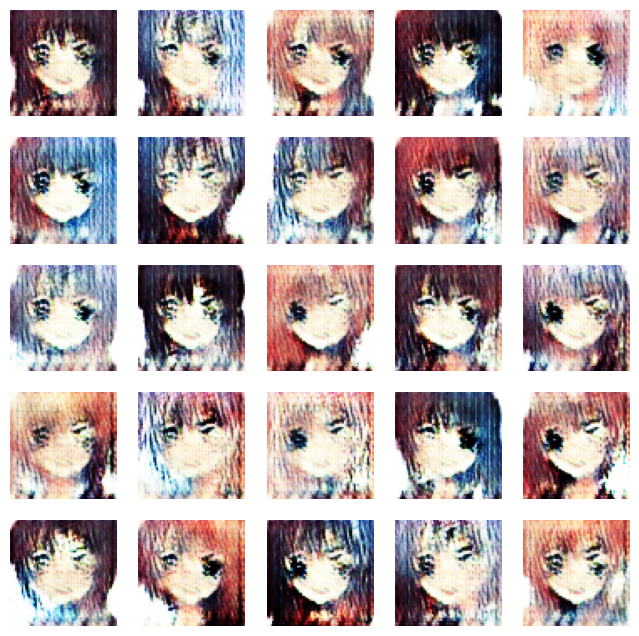

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6365 - g_loss: 1.5572
Epoch 7/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6213 - g_loss: 1.4521

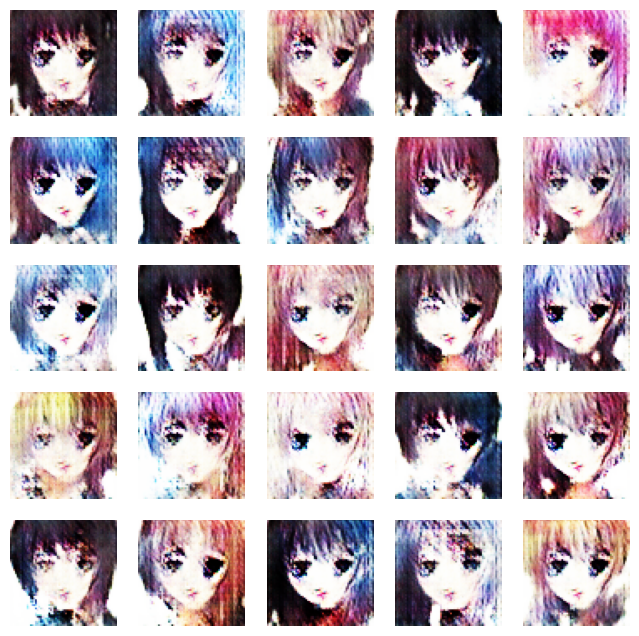

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6213 - g_loss: 1.4523
Epoch 8/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.5743 - g_loss: 1.4347

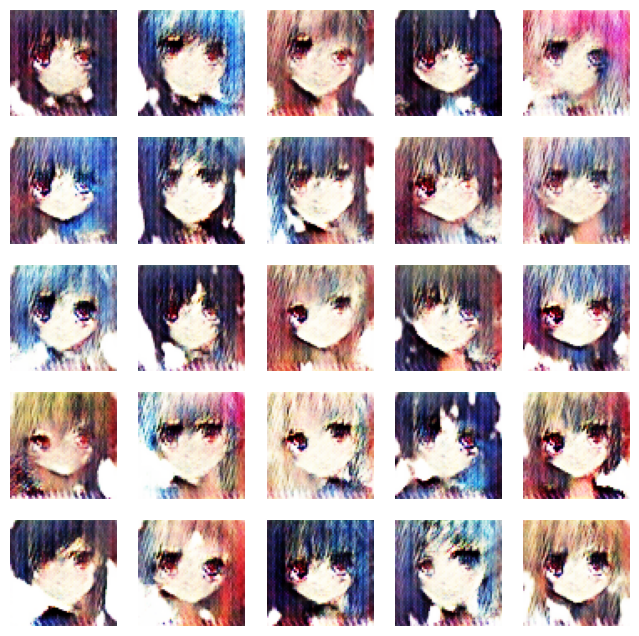

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.5743 - g_loss: 1.4348
Epoch 9/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.5560 - g_loss: 1.6060

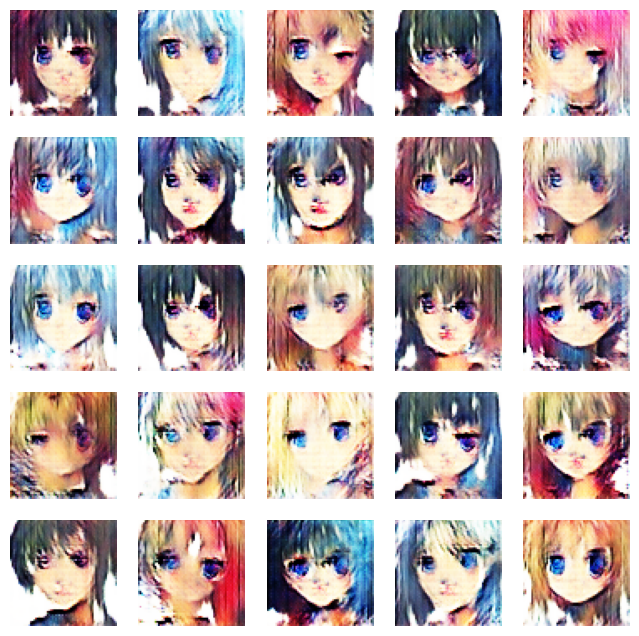

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.5560 - g_loss: 1.6058
Epoch 10/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6186 - g_loss: 1.2815

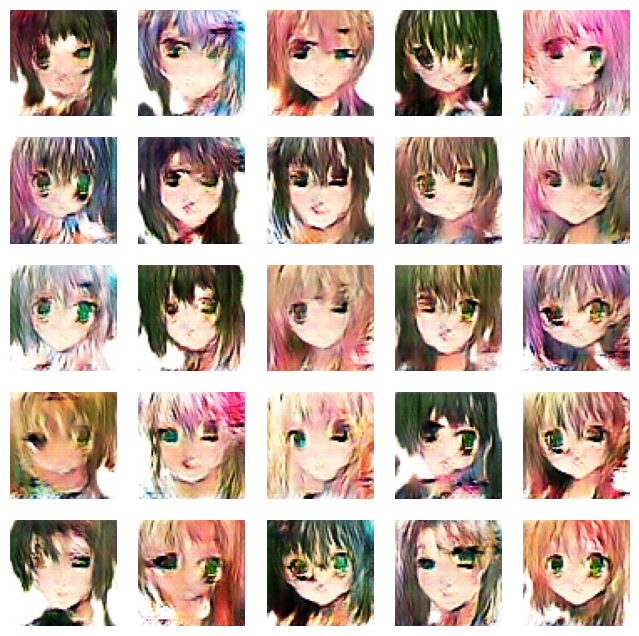

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6187 - g_loss: 1.2814
Epoch 11/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6749 - g_loss: 1.0927

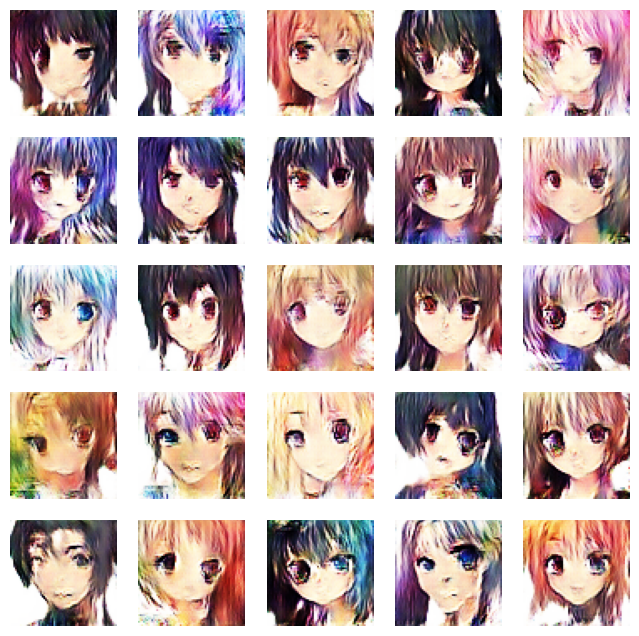

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6749 - g_loss: 1.0927
Epoch 12/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6732 - g_loss: 1.0258

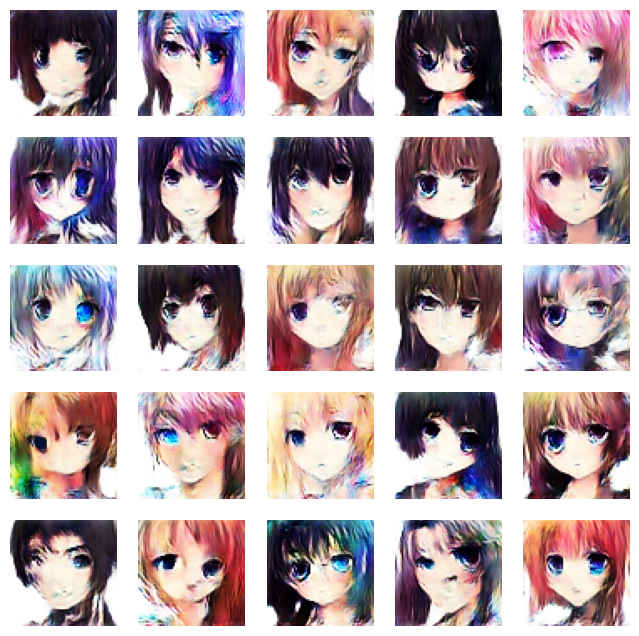

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6732 - g_loss: 1.0258
Epoch 13/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6789 - g_loss: 0.9820

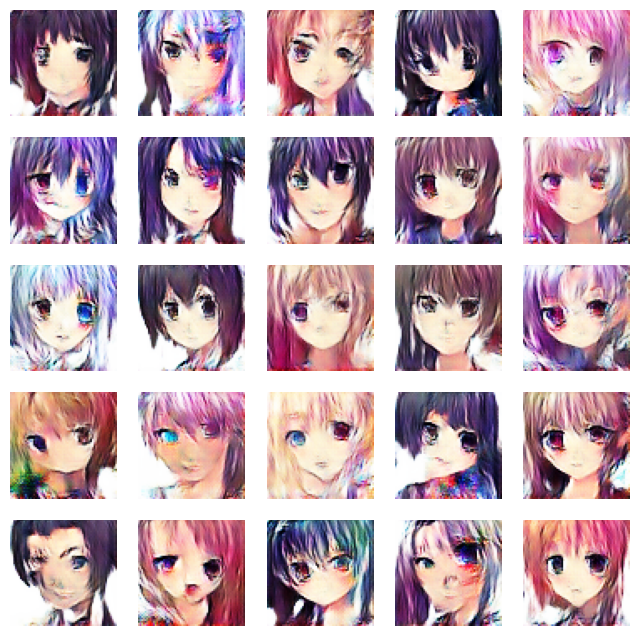

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6789 - g_loss: 0.9820
Epoch 14/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6824 - g_loss: 0.9600

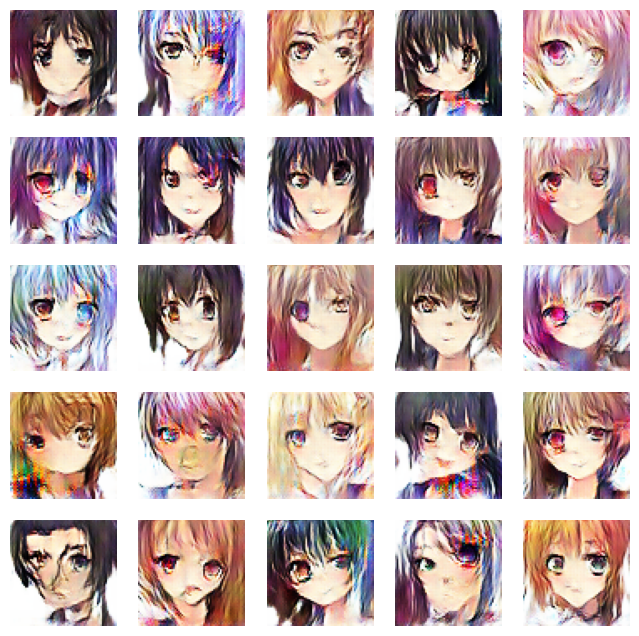

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6825 - g_loss: 0.9599
Epoch 15/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6876 - g_loss: 0.9281

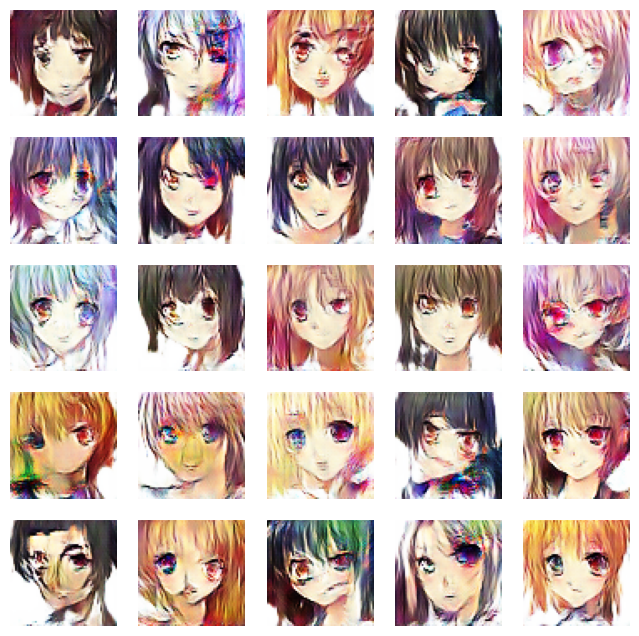

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6876 - g_loss: 0.9280
Epoch 16/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6903 - g_loss: 0.8890

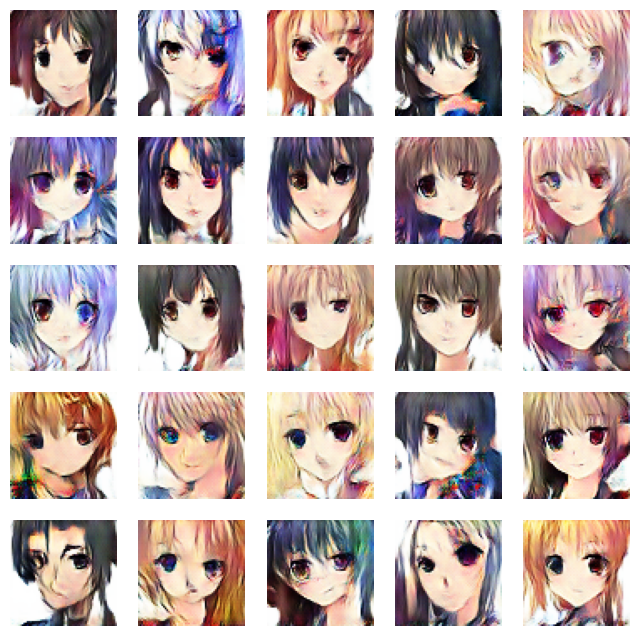

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6903 - g_loss: 0.8889
Epoch 17/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6960 - g_loss: 0.8739

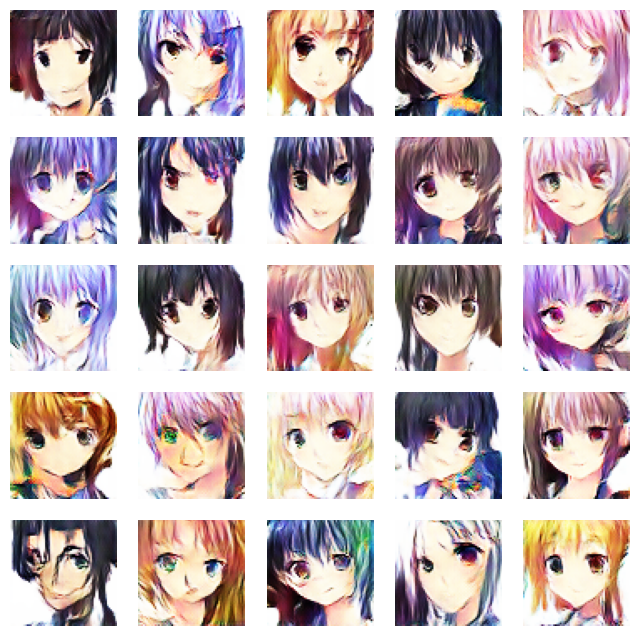

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6960 - g_loss: 0.8739
Epoch 18/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6923 - g_loss: 0.8567

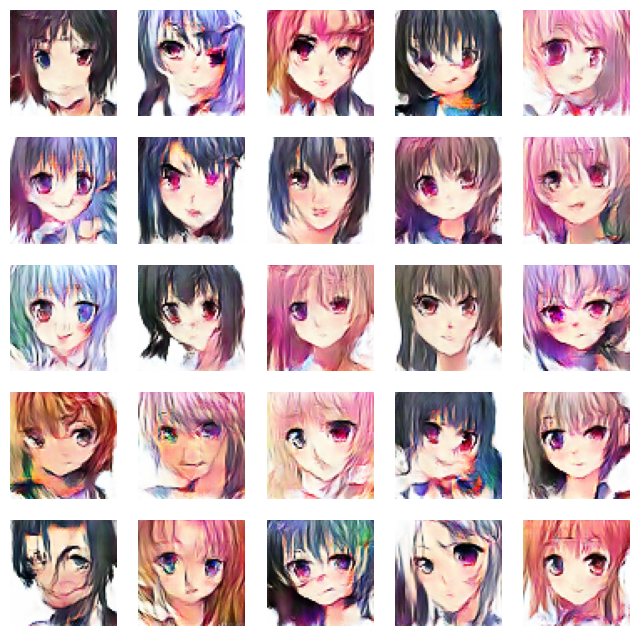

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6923 - g_loss: 0.8567
Epoch 19/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6906 - g_loss: 0.8518

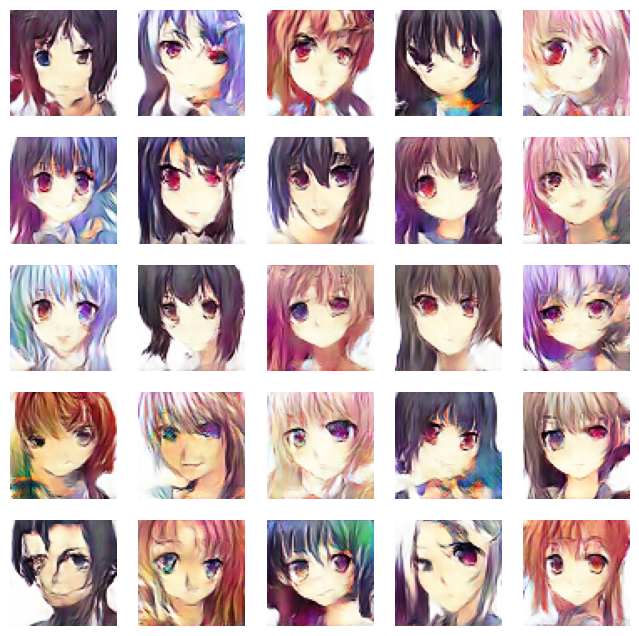

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6906 - g_loss: 0.8517
Epoch 20/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6905 - g_loss: 0.8544

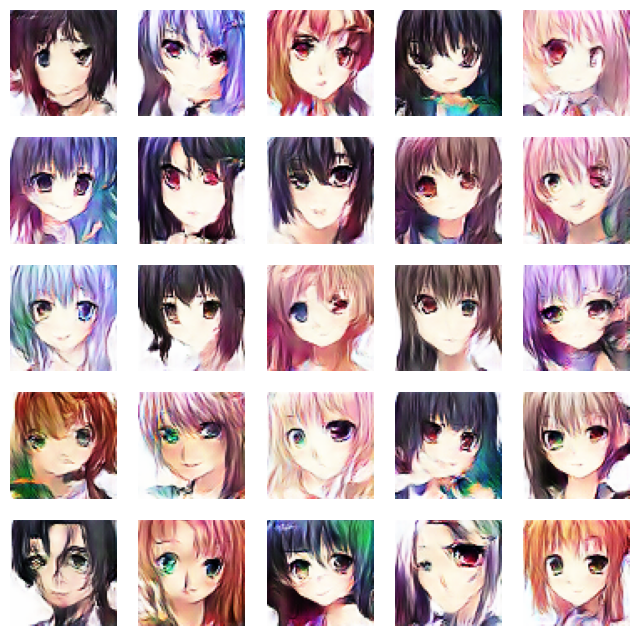

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6905 - g_loss: 0.8544
Epoch 21/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6874 - g_loss: 0.8375

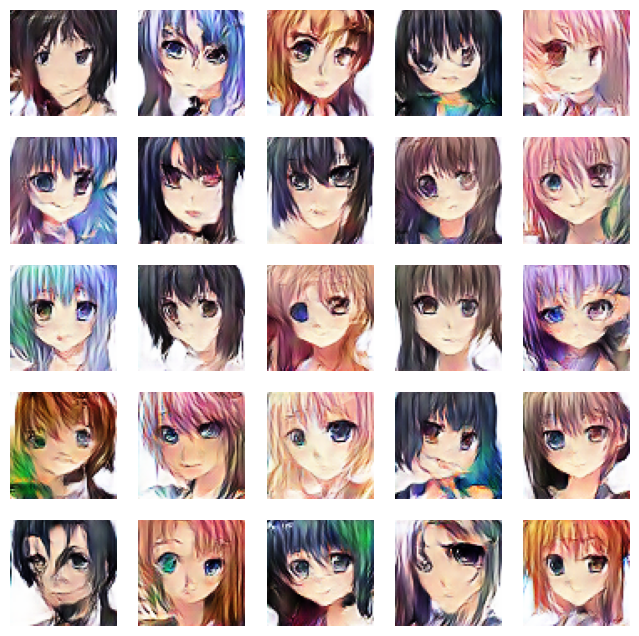

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6874 - g_loss: 0.8375
Epoch 22/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6886 - g_loss: 0.8322

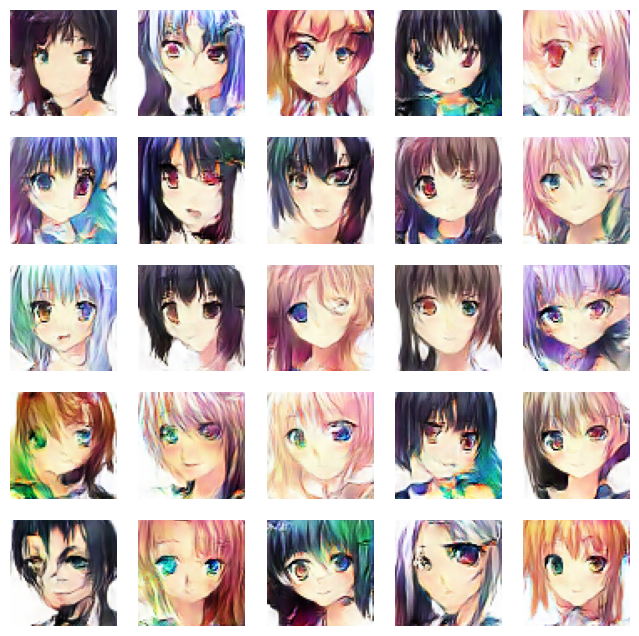

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6886 - g_loss: 0.8322
Epoch 23/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6832 - g_loss: 0.8297

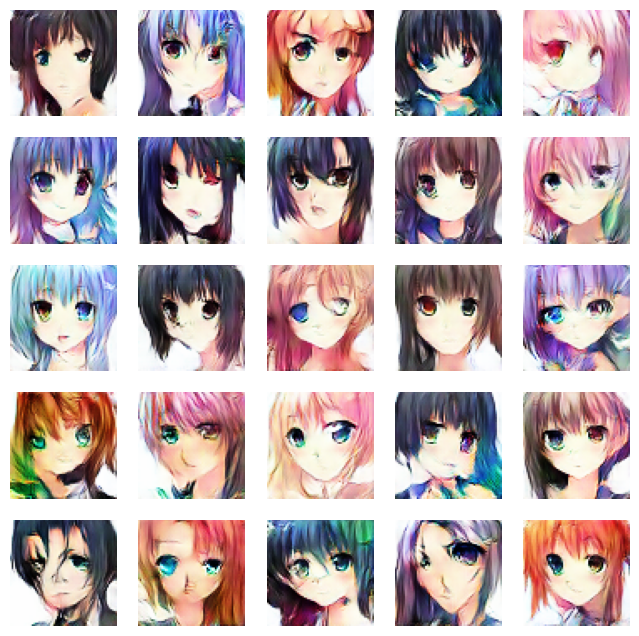

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6832 - g_loss: 0.8298
Epoch 24/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6834 - g_loss: 0.8377

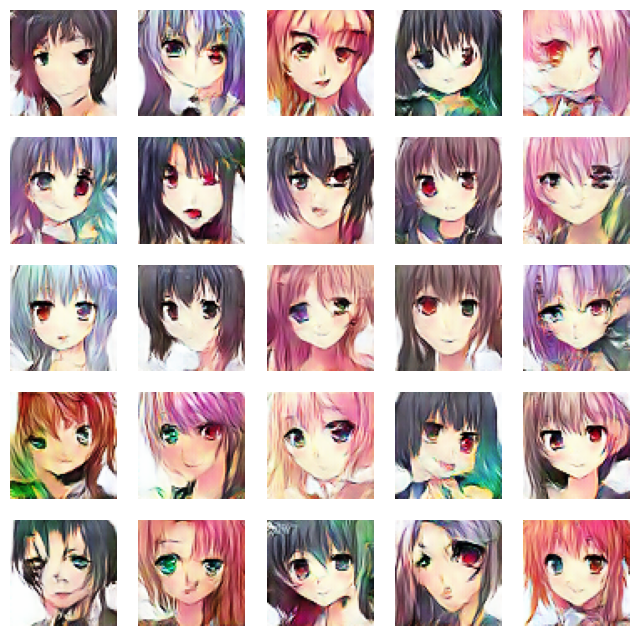

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6834 - g_loss: 0.8377
Epoch 25/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - d_loss: 0.6826 - g_loss: 0.8273

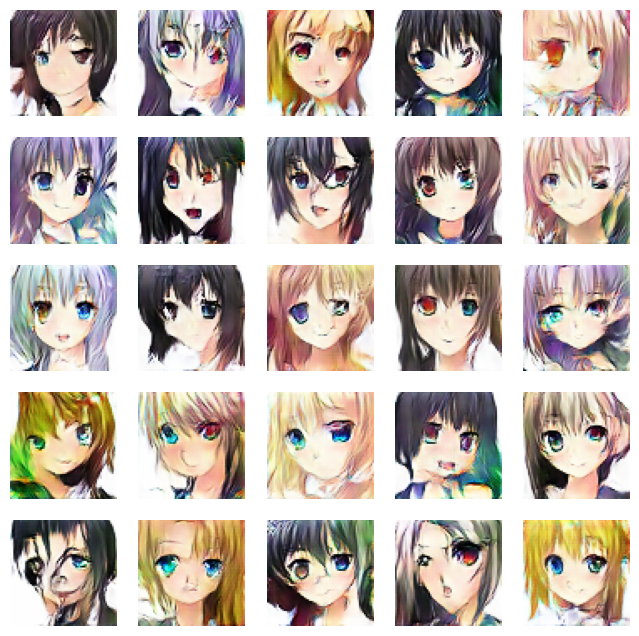

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6826 - g_loss: 0.8273
Epoch 26/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6796 - g_loss: 0.8355

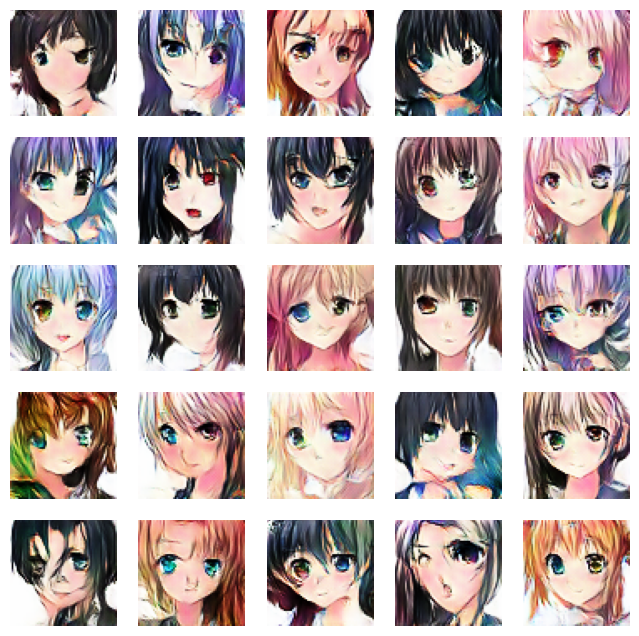

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6796 - g_loss: 0.8355
Epoch 27/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6797 - g_loss: 0.8376

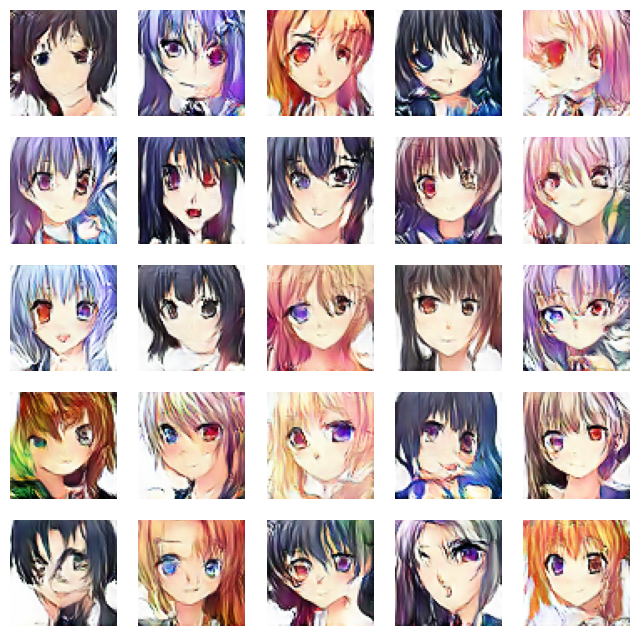

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6797 - g_loss: 0.8376
Epoch 28/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6750 - g_loss: 0.8384

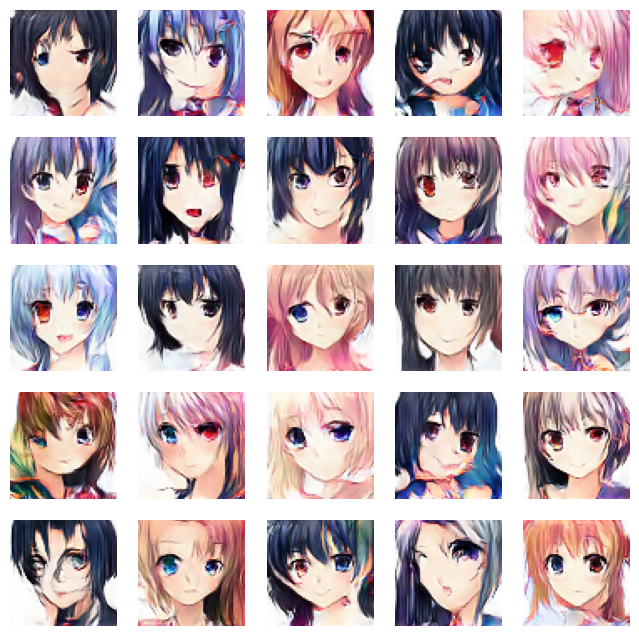

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6750 - g_loss: 0.8384
Epoch 29/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6718 - g_loss: 0.8378

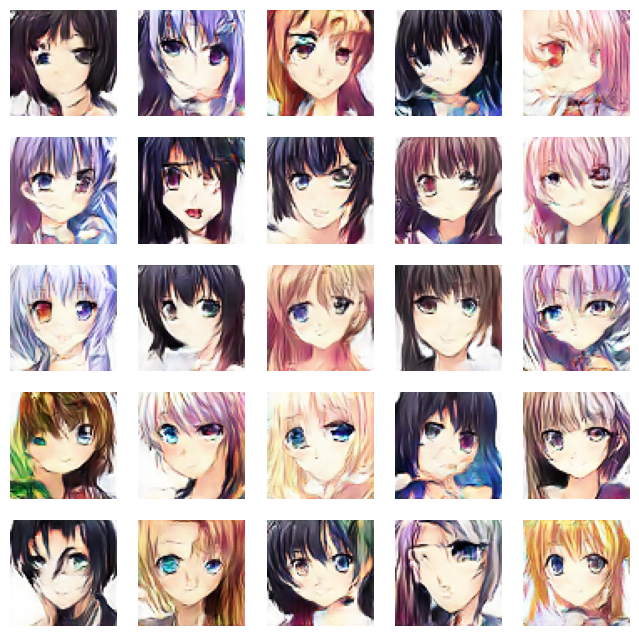

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6718 - g_loss: 0.8378
Epoch 30/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6719 - g_loss: 0.8439

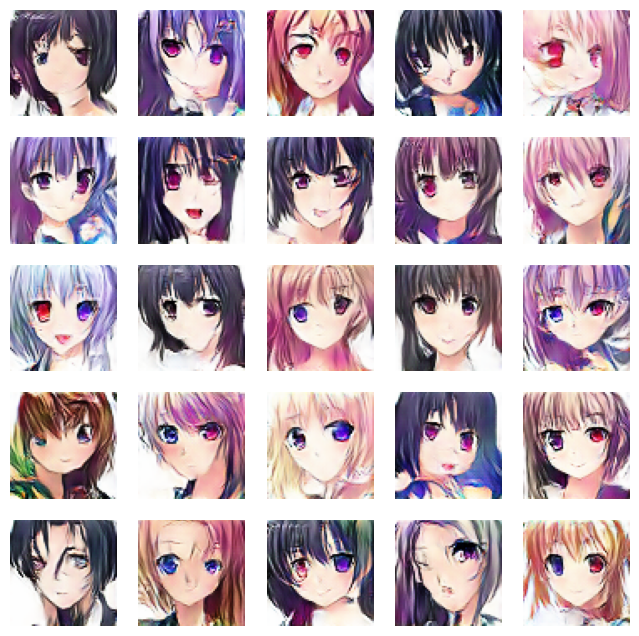

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 38ms/step - d_loss: 0.6719 - g_loss: 0.8439
Epoch 31/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - d_loss: 0.6666 - g_loss: 0.8488

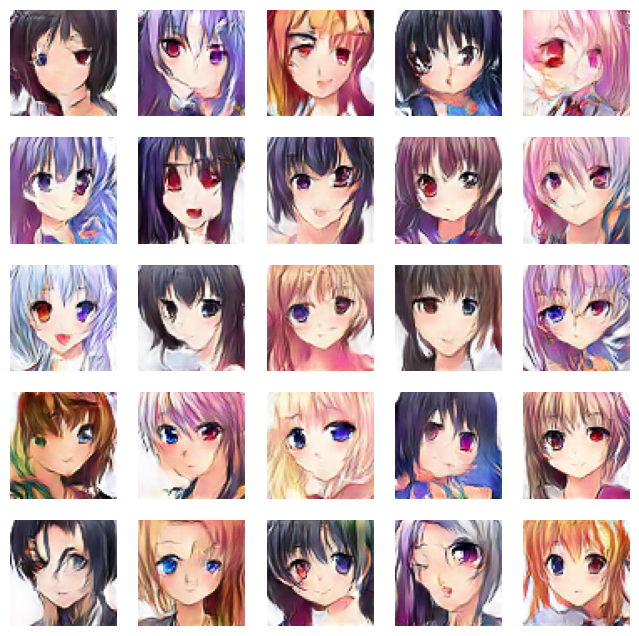

674/674 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - d_loss: 0.6666 - g_loss: 0.8488
Epoch 32/50
161/674 ━━━━━━━━━━━━━━━━━━━━ 18s 36ms/step - d_loss: 0.6690 - g_loss: 0.8638

In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images,epochs = N_EPOCHS, callbacks=[DCGANMonitor()])

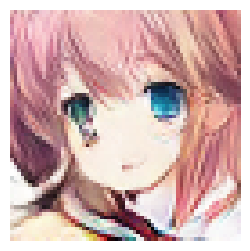

In [25]:
noise = tf.random.normal([1,100])
fig = plt.figure(figsize=(3,3))
g_img = dcgan.generator(noise)
g_img = (g_img * 127.5) + 127.5
g_img.numpy()

img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()